# Lokta-Volterra

In [1]:
using Pkg
Pkg.activate(".")
Pkg.develop(path="../")
Pkg.instantiate()

  Activating project at `~/PhD/MicroCanonicalHMC.jl/test`
   Resolving package versions...
  No Changes to `~/PhD/MicroCanonicalHMC.jl/test/Project.toml`
  No Changes to `~/PhD/MicroCanonicalHMC.jl/test/Manifest.toml`


In [2]:
using Turing
using DifferentialEquations
using LinearAlgebra
using PyPlot

# Set a seed for reproducibility.
using Random
Random.seed!(14)

using Revise
using MicroCanonicalHMC

# PDE-Modelling

In [3]:
# Define Lotka-Volterra model.
function lotka_volterra(du, u, p, t)
    # Model parameters.
    α, β, γ, δ = p
    # Current state.
    x, y = u

    # Evaluate differential equations.
    du[1] = (α - β * y) * x # prey
    du[2] = (δ * x - γ) * y # predator

    return nothing
end

# Define initial-value problem.
u0 = [1.0, 1.0]
p = [1.5, 1.0, 3.0, 1.0]
tspan = (0.0, 10.0)
prob = ODEProblem(lotka_volterra, u0, tspan, p);

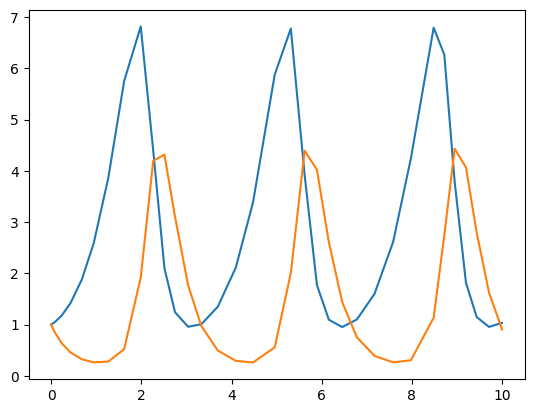

1-element Vector{PyCall.PyObject}:
 PyObject <matplotlib.lines.Line2D object at 0x7f3a618e3a60>

In [4]:
sol = solve(prob, Tsit5())
u_1 = [u[1] for u in sol.u]
u_2 = [u[2] for u in sol.u]
plt.plot(sol.t, u_1)
plt.plot(sol.t, u_2)

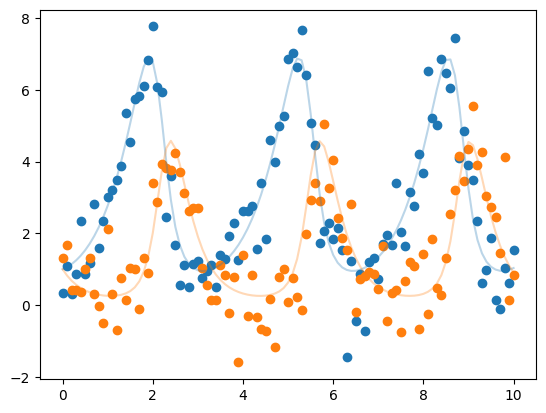

PyObject <matplotlib.collections.PathCollection object at 0x7f3a5d36f3d0>

In [5]:
sol = solve(prob, Tsit5(); saveat=0.1)
u_1 = [u[1] for u in sol.u]
u_2 = [u[2] for u in sol.u]
odedata = Array(sol) + 0.8 * randn(size(Array(sol)))
odedata[1, :]
# Plot simulation and noisy observations.
plt.plot(sol.t, u_1; alpha=0.3)
plt.plot(sol.t, u_2; alpha=0.3)
plt.scatter(sol.t, odedata[1, :]; label="")
plt.scatter(sol.t, odedata[2, :]; label="")

In [6]:
@model function fitlv(data, prob)
    # Prior distributions.
    σ ~ InverseGamma(2, 3)
    α ~ truncated(Normal(1.5, 0.5), 0.5, 2.5)
    β ~ truncated(Normal(1.2, 0.5), 0, 2)
    γ ~ truncated(Normal(3.0, 0.5), 1, 4)
    δ ~ truncated(Normal(1.0, 0.5), 0, 2)

    # Simulate Lotka-Volterra model. 
    p = [α, β, γ, δ]
    predicted = solve(prob, Tsit5(); p=p, saveat=0.1)

    # Observations.
    for i in 1:length(predicted)
        data[:, i] ~ MvNormal(predicted[i], σ^2 * I)
    end

    return nothing
end

model = fitlv(odedata, prob);

## MCHMC

In [7]:
target = TuringTarget(model);

In [14]:
spl = MCHMC(10_000, 0.01; sigma=ones(target.d), adaptive=true)
samples_mchmc = Sample(spl, target, 100_000; dialog=true);

[ Info: Tuning eps ⏳
[ Info: Tuning L ⏳
MCHMC (tuning):  17%|██████                             |  ETA: 0:00:03

Burn in step: 2000
eps --->0.0035311777400512086
L   --->0.0013530785509004734
 


MCHMC (tuning):  39%|█████████████▊                     |  ETA: 0:00:02

Burn in step: 4000
eps --->0.011789835790428091
L   --->0.003420843396334332
 


MCHMC (tuning):  60%|█████████████████████              |  ETA: 0:00:01

Burn in step: 6000
eps --->0.011122252632229164
L   --->0.002693742934804895
 


MCHMC (tuning):  79%|███████████████████████████▉       |  ETA: 0:00:01

Burn in step: 8000
eps --->0.010108573737568356
L   --->0.0022488628425422937
 


2mMCHMC (tuning): 100%|███████████████████████████████████| Time: 0:00:03

Burn in step: 10000
eps --->0.01098648069899275
L   --->0.002327008056956742
 


[ Info: eps: 0.01098648069899275
[ Info: L: 0.002327008056956742
[ Info: nu: 59.18107875533348
[ Info: sigma: [1.0, 1.0, 1.0, 1.0, 1.0]
[ Info: adaptive: true
2mMCHMC: 100%|████████████████████████████████████████████| Time: 0:00:29

In [15]:
σ_mchmc = [sample[1] for sample in samples_mchmc]
α_mchmc = [sample[2] for sample in samples_mchmc] 
β_mchmc = [sample[3] for sample in samples_mchmc]  
γ_mchmc = [sample[4] for sample in samples_mchmc]
δ_mchmc = [sample[5] for sample in samples_mchmc];

In [10]:
ESSs, rhat = Summarize(samples_mchmc)
ESS = mean(ESSs)
ESS

12545.553077305425

## NUTS

In [11]:
# Sample 3 independent chains with forward-mode automatic differentiation (the default).
samples_hmc = sample(model, NUTS(0.65), 5000; progress=true)

┌ Info: Found initial step size
└   ϵ = 0.05
Sampling: 100%|█████████████████████████████████████████| Time: 0:00:43


Chains MCMC chain (5000×17×1 Array{Float64, 3}):

Iterations        = 1001:1:6000
Number of chains  = 1
Samples per chain = 5000
Wall duration     = 49.0 seconds
Compute duration  = 49.0 seconds
parameters        = σ, α, β, γ, δ
internals         = lp, n_steps, is_accept, acceptance_rate, log_density, hamiltonian_energy, hamiltonian_energy_error, max_hamiltonian_energy_error, tree_depth, numerical_error, step_size, nom_step_size

Summary Statistics
  parameters      mean       std      mcse    ess_bulk    ess_tail      rhat   ⋯
      Symbol   Float64   Float64   Float64     Float64     Float64   Float64   ⋯

           σ    0.7768    0.0388    0.0008   2554.2259   2507.4143    1.0022   ⋯
           α    1.5418    0.0507    0.0014   1327.6411   1606.1038    0.9998   ⋯
           β    1.0519    0.0489    0.0012   1713.3896   2051.4440    1.0000   ⋯
           γ    2.8749    0.1340    0.0036   1378.9962   1636.5791    0.9998   ⋯
           δ    0.9609    0.0489    0.0013   1358.7649   161

In [12]:
σ_hmc = vec(samples_hmc["σ"])
α_hmc = vec(samples_hmc["α"])
β_hmc = vec(samples_hmc["β"]) 
γ_hmc = vec(samples_hmc["γ"])
δ_hmc = vec(samples_hmc["δ"]);

## Comp

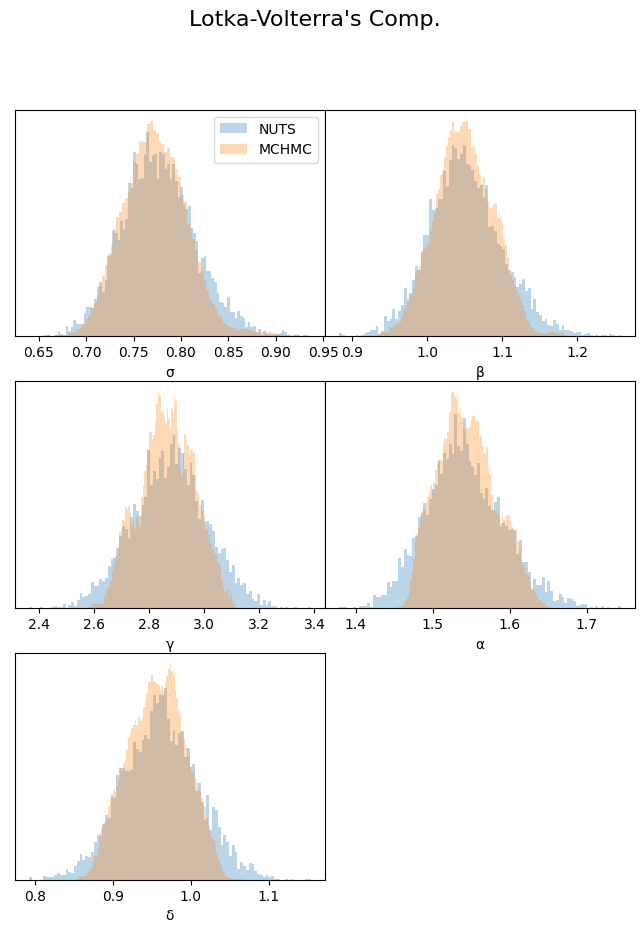

(0.0, 1.0, 0.0, 1.0)

In [16]:
fig, axis = plt.subplots(3, 2, figsize=(8,10))
fig.suptitle("Lotka-Volterra's Comp.", fontsize=16)

fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0)

axis[1,1].hist(σ_hmc, bins=100, density=true, alpha = 0.3, label="NUTS")
axis[1,1].hist(σ_mchmc, bins=100, density=true, alpha = 0.3, label="MCHMC")
axis[1,1].legend()
axis[1,1].set_xlabel("σ")
axis[1,1].set_yticks([])

axis[1,2].hist(β_hmc, bins=100, density=true, alpha = 0.3)
axis[1,2].hist(β_mchmc, bins=100, density=true, alpha = 0.3)
axis[1,2].set_xlabel("β")
axis[1,2].set_yticks([])

axis[2,1].hist(γ_hmc, bins=100, density=true, alpha = 0.3)
axis[2,1].hist(γ_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,1].set_xlabel("γ")
axis[2,1].set_yticks([])

axis[2,2].hist(α_hmc, bins=100, density=true, alpha = 0.3)
axis[2,2].hist(α_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,2].set_xlabel("α")
axis[2,2].set_yticks([])

axis[3,1].hist(δ_hmc, bins=100, density=true, alpha = 0.3)
axis[3,1].hist(δ_mchmc, bins=100, density=true, alpha = 0.3)
axis[3,1].set_xlabel("δ")
axis[3,1].set_yticks([])

axis[3,2].axis("off")

# SDE-Modelling

In [ ]:
u0 = [1.0, 1.0]
tspan = (0.0, 10.0)
function multiplicative_noise!(du, u, p, t)
    x, y = u
    du[1] = p[5] * x
    return du[2] = p[6] * y
end
p = [1.5, 1.0, 3.0, 1.0, 0.1, 0.1]

function lotka_volterra!(du, u, p, t)
    x, y = u
    α, β, γ, δ = p
    du[1] = dx = α * x - β * x * y
    return du[2] = dy = δ * x * y - γ * y
end

prob_sde = SDEProblem(lotka_volterra!, multiplicative_noise!, u0, tspan, p)
# = EnsembleProblem(prob_sde)
#data = solve(ensembleprob, SOSRI(); saveat=0.1, trajectories=1000)
;

In [14]:
@model function fitlv_sde(data, prob)
    # Prior distributions.
    σ ~ InverseGamma(2, 3)
    α ~ truncated(Normal(1.3, 0.5), 0.5, 2.5)
    β ~ truncated(Normal(1.2, 0.25), 0.5, 2)
    γ ~ truncated(Normal(3.2, 0.25), 2.2, 4.0)
    δ ~ truncated(Normal(1.2, 0.25), 0.5, 2.0)
    ϕ1 ~ truncated(Normal(0.12, 0.3), 0.05, 0.25)
    ϕ2 ~ truncated(Normal(0.12, 0.3), 0.05, 0.25)

    # Simulate stochastic Lotka-Volterra model.
    p = [α, β, γ, δ, ϕ1, ϕ2]
    predicted = solve(prob, SOSRI(); p=p, saveat=0.1)

    # Early exit if simulation could not be computed successfully.
    if predicted.retcode !== :Success
        Turing.@addlogprob! -Inf
        return nothing
    end

    # Observations.
    for i in 1:length(predicted)
        data[:, i] ~ MvNormal(predicted[i], σ^2 * I)
    end

    return nothing
end;

In [15]:
model_sde = fitlv_sde(odedata, prob_sde);

## MCHMC

In [16]:
target = TuringTarget(model_sde);

In [17]:
spl = MCHMC(10_000, 0.0001; sigma=ones(target.d), adaptive=true)
samples_mchmc = Sample(spl, target, 100_000;
                       init_x=[1.5, 1.3, 1.2, 2.7, 1.2, 0.12, 0.12],
                       dialog=true);

[ Info: Tuning eps ⏳
[ Info: Tuning L ⏳
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiff

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC (tuning):  15%|█████▏                             |  ETA: 0:00:03┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC (tuning):  19%|██████▊                            |  ETA: 0:00:02┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

Burn in step: 2000
eps --->NaN
L   --->NaN
 


┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/r

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC:   2%|▊                                           |  ETA: 0:00:23┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC:   3%|█▎                                          |  ETA: 0:00:24┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:   4%|█▋                                          |  ETA: 0:00:23┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  16%|██████▉                                     |  ETA: 0:00:19┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  18%|████████                                    |  ETA: 0:00:19┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC:  30%|█████████████▎                              |  ETA: 0:00:16┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  31%|█████████████▌                              |  ETA: 0:00:16┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  45%|███████████████████▉                        |  ETA: 0:00:12┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/r

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC:  57%|█████████████████████████▏                  |  ETA: 0:00:10┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  57%|█████████████████████████▎                  |  ETA: 0:00:10┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  58%|█████████████████████████▊                  |  ETA: 0:00:09┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC:  83%|████████████████████████████████████▋       |  ETA: 0:00:04┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC:  85%|█████████████████████████████████████▎      |  ETA: 0:00:04┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  97%|██████████████████████████████████████████▋ |  ETA: 0:00:01┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [18]:
σ_mchmc = [sample[1] for sample in samples_mchmc]
α_mchmc = [sample[2] for sample in samples_mchmc] 
β_mchmc = [sample[3] for sample in samples_mchmc]  
γ_mchmc = [sample[4] for sample in samples_mchmc]
δ_mchmc = [sample[5] for sample in samples_mchmc]
ϕ1_mchmc = [sample[6] for sample in samples_mchmc]
ϕ2_mchmc = [sample[7] for sample in samples_mchmc];

In [19]:
ESSs, rhat = Summarize(samples_mchmc)
ESS = mean(ESSs)
ESS

201.07774619316223

## NUTS

In [ ]:
# Sample 3 independent chains with forward-mode automatic differentiation (the default).
samples_hmc = sample(model_sde, NUTS(0.25), 5000; progress=true)

In [ ]:
σ_hmc = vec(samples_hmc["σ"])
α_hmc = vec(samples_hmc["α"])
β_hmc = vec(samples_hmc["β"]) 
γ_hmc = vec(samples_hmc["γ"])
δ_hmc = vec(samples_hmc["δ"])
ϕ1_hmc = vec(samples_hmc["ϕ1"])
ϕ2_hmc = vec(samples_hmc["ϕ2"]);

## Comp

In [ ]:
fig, axis = plt.subplots(4, 2, figsize=(8,12))
fig.suptitle("Lotka-Volterra's Comp.", fontsize=16)

fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0)

axis[1,1].hist(σ_hmc, bins=100, density=true, alpha = 0.3, label="NUTS")
axis[1,1].hist(σ_mchmc, bins=100, density=true, alpha = 0.3, label="MCHMC")
axis[1,1].legend()
axis[1,1].set_xlabel("σ")
axis[1,1].set_yticks([])

axis[1,2].hist(β_hmc, bins=100, density=true, alpha = 0.3)
axis[1,2].hist(β_mchmc, bins=100, density=true, alpha = 0.3)
axis[1,2].set_xlabel("β")
axis[1,2].set_yticks([])

axis[2,1].hist(γ_hmc, bins=100, density=true, alpha = 0.3)
axis[2,1].hist(γ_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,1].set_xlabel("γ")
axis[2,1].set_yticks([])

axis[2,2].hist(α_hmc, bins=100, density=true, alpha = 0.3)
axis[2,2].hist(α_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,2].set_xlabel("α")
axis[2,2].set_yticks([])

axis[3,1].hist(δ_hmc, bins=100, density=true, alpha = 0.3)
axis[3,1].hist(δ_mchmc, bins=100, density=true, alpha = 0.3)
axis[3,1].set_xlabel("δ")
axis[3,1].set_yticks([])

axis[3,2].axis("off")

axis[4,1].hist(ϕ1_hmc, bins=100, density=true, alpha = 0.3)
axis[4,1].hist(ϕ1_mchmc, bins=100, density=true, alpha = 0.3)
axis[4,1].set_xlabel("γ")
axis[4,1].set_yticks([])

axis[4,2].hist(ϕ2_hmc, bins=100, density=true, alpha = 0.3)
axis[4,2].hist(ϕ2_mchmc, bins=100, density=true, alpha = 0.3)
axis[4,2].set_xlabel("α")
axis[4,2].set_yticks([])
;